# Quick Start Tutorial of the basic functionality of MetaDrive

Welcome to try out MetaDrive!

MetaDrive v0.2.5 supports two running modes:

1. **With 3D rendering functionality**: MetaDrive can easily install and run in personal computer, but may need special treatments for 3D rendering in headless machine and cloud servers.

2. **Without 3D rendering functionality**: MetaDrive can easily install and run in any machine. In this Colab notebook, we demonstrate MetaDrive in this mode and the renderer will be the **2D** **Pygame** renderer.

In this tutorial, we will navigate you through the installation and some basic functionality of MetaDrive!

## Installation

You can install MetaDrive easily.

In [1]:
#@title Collect the MetaDrive

# %pip install git+https://github.com/metadriverse/metadrive.git

In [8]:
# # @title Test Installation
# from metadrive import MetaDriveEnv
# from metadrive.examples import expert

# env = MetaDriveEnv()
# print("\nThe action space: {}".format(env.action_space))
# print("\nThe observation space: {}\n".format(env.observation_space))
# try:
#     env.reset()
#     for i in range(100):
#         env.step(env.action_space.sample())
#     print("Successfully run MetaDrive")
# except:
#     print("Fail to run MetaDrive!")
# finally:
#     env.close()



## Basic Functionality

Starting the environment ...



:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Arriving Destination: True

Episode reward:  436.2015321690714

Episode cost:  0.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 25.219848578478757, 'steering': 0.01341085082073892, 'acceleration': 0.022114181123864332, 'step_energy': 0.02929000278610469, 'episode_energy': 17.824993957811085, 'policy': 'EnvInputPolicy', 'raw_action': (0.01341085082073892, 0.022114181123864332), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': False, 'arrive_dest': True, 'max_step': False, 'crash': False, 'step_reward': 0.7318258994281733, 'cost': 0, 'episode_reward': 436.2015321690714, 'episode_length': 529}

MetaDrive successfully run!

Generate gif...

Open gif...


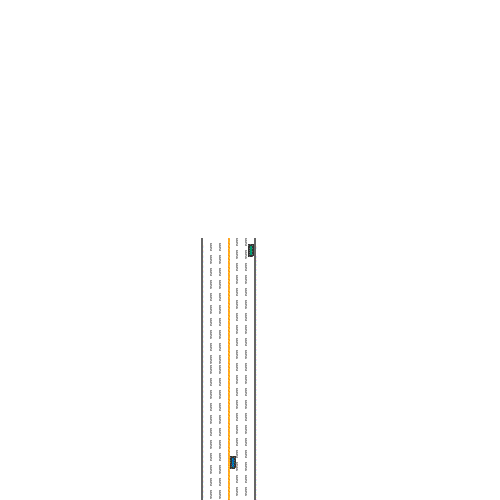

In [2]:
# @title A minimalist example of using MetaDrive with the built-in PPO expert policy

import os
os.environ['SDL_VIDEODRIVER']='dummy'
# Note: this step is only for cheating Colab

from metadrive import MetaDriveEnv
from metadrive.examples import expert

# Set the envrionment config
config = {"start_seed": 500, 
          "environment_num":1,
          "traffic_density":0.1,
          "accident_prob":0.8
          }

env = MetaDriveEnv(config)

print("Starting the environment ...\n")

ep_reward = 0.0
ep_cost = 0.0
obs = env.reset()
frames = []
for i in range(1000):
    obs, reward, done, info = env.step(expert(env.vehicle))
    ep_reward += reward
    ep_cost += info["cost"]
    frame = env.render(mode="top_down", film_size=(800, 800), track_target_vehicle=True, screen_size=(500, 500))
    frames.append(frame)
    if done:
        print("Arriving Destination: {}".format(info["arrive_dest"]))
        print("\nEpisode reward: ", ep_reward)
        print("\nEpisode cost: ", ep_cost)
        break

print("\nThe last returned information: {}".format(info))

env.close()
print("\nMetaDrive successfully run!")

# render image
print("\nGenerate gif...")
import pygame
import numpy as np
from PIL import Image

imgs = [pygame.surfarray.array3d(frame) for frame in frames]
imgs = [Image.fromarray(img) for img in imgs]
imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
print("\nOpen gif...")
from IPython.display import Image
Image(open("demo.gif", 'rb').read())


Starting the environment ...



:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager



MetaDrive successfully run!

Generate gif...

Open gif...


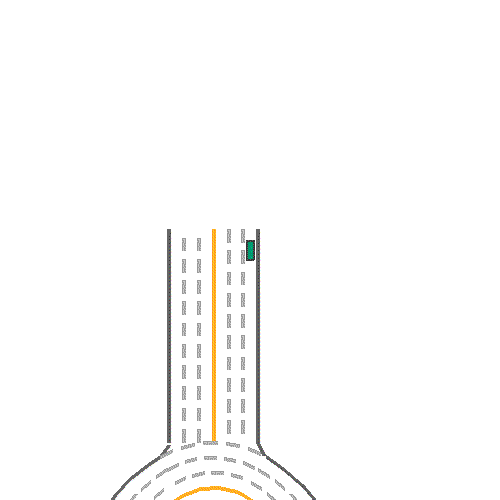

In [3]:
from metadrive import SafeMetaDriveEnv
from metadrive.examples import expert

# Set the envrionment config
config = {"start_seed": 500, 
          "environment_num":2,
          "traffic_density":0.1,
          "accident_prob":0.8
          }

env = SafeMetaDriveEnv(config)

print("Starting the environment ...\n")

ep_reward = 0.0
ep_cost = 0.0
obs = env.reset()
frames = []
for i in range(1000):
    obs, reward, done, info = env.step(expert(env.vehicle))
    ep_reward += reward
    ep_cost += info["cost"]
    frame = env.render(mode="top_down", film_size=(1500, 1500), track_target_vehicle=True, screen_size=(500, 500))
    frames.append(frame)
    if done:
        print("Arriving Destination: {}".format(info["arrive_dest"]))
        print("\nEpisode reward: ", ep_reward)
        print("\nEpisode cost: ", ep_cost)
        break

env.close()
print("\nMetaDrive successfully run!")

# render image
print("\nGenerate gif...")
import pygame
import numpy as np
from PIL import Image

imgs = [pygame.surfarray.array3d(frame) for frame in frames]
imgs = [Image.fromarray(img) for img in imgs]
imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
print("\nOpen gif...")
from IPython.display import Image
Image(open("demo.gif", 'rb').read())

In [28]:
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=10,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            text={
                "w": "Lane Follow",
                "s": "Brake",
                "a": "Left Lane Change",
                "d": "Right Lane Change",
                "r": "Reset",
                "f": "Unlimited FPS",
                "Current Command": env.command
            }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:
  CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Starting the environment ...

Arriving Destination: False

Episode reward:  69.25995166788428

Episode cost:  1.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 9.738230117467095, 'steering': -0.41172233088352317, 'acceleration': -0.2779180688487281, 'step_energy': 0.011878568645323814, 'episode_energy': 2.999050683405984, 'policy': 'EnvInputPolicy', 'raw_action': (-0.41172233088352317, -0.2779180688487281), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': True, 'arrive_dest': False, 'max_step': False, 'crash': False, 'step_reward': 0.28427836278674806, 'cost': 1.0, 'total_cost': 1.0, 'episode_reward': 69.25995166788428, 'episode_length': 123}

MetaDrive successfully run!


In [26]:
### For add new action
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    },
    "Brake and Left Lane Change": {
        0: [(20, -20), (1, -8.5)]
    },
    "Brake and Right Lane Change": {
        0: [(20, -20), (1, 7)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=20,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            text={
                "w": "Lane Follow",
                "s": "Brake",
                "a": "Left Lane Change",
                "d": "Right Lane Change",
                "r": "Reset",
                "f": "Unlimited FPS",
                "g": "Brake and Left Lane Change",
                "z": "Brake and Right Lane Change",
                "Current Command": env.command
            }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:
  CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Starting the environment ...

Arriving Destination: True

Episode reward:  547.4435129670073

Episode cost:  0.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 19.418701570877857, 'steering': 0.028596912744623466, 'acceleration': 0.15598221894204647, 'step_energy': 0.021136872778824183, 'episode_energy': 23.15841863950088, 'policy': 'EnvInputPolicy', 'raw_action': (0.028596912744623466, 0.15598221894204647), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': False, 'arrive_dest': True, 'max_step': False, 'crash': False, 'step_reward': 0.5581778220008201, 'cost': 0, 'total_cost': 0, 'episode_reward': 547.4435129670073, 'episode_length': 641}

MetaDrive successfully run!


In [18]:
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=4,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            # text={
            #     "w": "Lane Follow",
            #     "s": "Brake",
            #     "a": "Left Lane Change",
            #     "d": "Right Lane Change",
            #     "r": "Reset",
            #     "f": "Unlimited FPS",
            #     "Current Command": env.command
            # }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:
  CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Starting the environment ...

Arriving Destination: False

Episode reward:  25.820663634279818

Episode cost:  1.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 11.983627250140637, 'steering': -0.2760457870674275, 'acceleration': -0.16351972560424458, 'step_energy': 0.013477221732287941, 'episode_energy': 1.3157723091076343, 'policy': 'EnvInputPolicy', 'raw_action': (-0.2760457870674275, -0.16351972560424458), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': True, 'arrive_dest': False, 'max_step': False, 'crash': False, 'step_reward': 0.33239667883806645, 'cost': 1.0, 'total_cost': 1.0, 'episode_reward': 25.820663634279818, 'episode_length': 68}

MetaDrive successfully run!


In [19]:
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=4,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            text={
                "w": "Lane Follow",
                "s": "Brake",
                "a": "Left Lane Change",
                "d": "Right Lane Change",
                "r": "Reset",
                "f": "Unlimited FPS",
                "Current Command": env.command
            }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:
  CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Starting the environment ...

Arriving Destination: False

Episode reward:  72.27982022006923

Episode cost:  1.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 17.317223357723677, 'steering': -0.17954949756696173, 'acceleration': -0.0859014250208305, 'step_energy': 0.01942334606802902, 'episode_energy': 3.4114426677078034, 'policy': 'EnvInputPolicy', 'raw_action': (-0.17954949756696173, -0.0859014250208305), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': True, 'arrive_dest': False, 'max_step': False, 'crash': False, 'step_reward': 0.4289951620096546, 'cost': 1.0, 'total_cost': 1.0, 'episode_reward': 72.27982022006923, 'episode_length': 109}

MetaDrive successfully run!


In [3]:
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=5,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            text={
                "w": "Lane Follow",
                "s": "Brake",
                "a": "Left Lane Change",
                "d": "Right Lane Change",
                "r": "Reset",
                "f": "Unlimited FPS",
                "Current Command": env.command
            }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:


Starting the environment ...



CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Arriving Destination: False

Episode reward:  40.150396061452504

Episode cost:  1.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 7.990170698506569, 'steering': -0.3545390444603439, 'acceleration': -0.23883080394205047, 'step_energy': 0.009483616352776954, 'episode_energy': 1.895856310371099, 'policy': 'EnvInputPolicy', 'raw_action': (-0.3545390444603439, -0.23883080394205047), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': True, 'arrive_dest': False, 'max_step': False, 'crash': False, 'step_reward': 0.24188697484774258, 'cost': 1.0, 'total_cost': 1.0, 'episode_reward': 40.150396061452504, 'episode_length': 89}

MetaDrive successfully run!


In [4]:
import numpy as np
from metadrive.examples.ppo_expert.numpy_expert import ckpt_path

from policydissect.metadrive.metadrive_env import MetaDriveEnv
from policydissect.utils.policy import ppo_inference_tf

# neuron at layer 0, index 123 is for lateral control
# neuron at layer 0, index 249 is for speed control
PPO_EXPERT_CONDITIONAL_CONTROL_MAP = {
    "Left Lane Change": {
        0: [(1, -8.5)]
    },
    "Right Lane Change": {
        0: [(1, 7)]
    },
    "Brake": {
        0: [(249, -20)]
    }
}

if __name__ == "__main__":
    builtin_ppo = np.load(ckpt_path)
    env = MetaDriveEnv(
        dict(
            use_render=True,
            start_seed=500,
            accident_prob=0.8,
            traffic_density=0.1,
            environment_num=4,
            vehicle_config=dict(
                lidar=dict(num_lasers=240, distance=50, num_others=4, gaussian_noise=0.0, dropout_prob=0.0)
            ),
        )
    )
    print("Starting the environment ...\n")
    ep_reward = 0.0
    ep_cost = 0.0
    o = env.reset()
    frames = []
    while True:
        o, r, d, i = env.step(ppo_inference_tf(builtin_ppo, o, 2, PPO_EXPERT_CONDITIONAL_CONTROL_MAP, env.command)[0])
        ep_reward += r
        ep_cost += i["cost"]
        frame = env.render(
            # text={
            #     "w": "Lane Follow",
            #     "s": "Brake",
            #     "a": "Left Lane Change",
            #     "d": "Right Lane Change",
            #     "r": "Reset",
            #     "f": "Unlimited FPS",
            #     "Current Command": env.command
            # }
        )
        frames.append(frame)
        if d:
            print("Arriving Destination: {}".format(i["arrive_dest"]))
            print("\nEpisode reward: ", ep_reward)
            print("\nEpisode cost: ", ep_cost)
            # o = env.reset()
            break
        
    print("\nThe last returned information: {}".format(i))
    env.close()
    print("\nMetaDrive successfully run!")
    
    # print("\nGenerate gif...")
    # import pygame
    # import numpy as np
    # from PIL import Image

    # imgs = [pygame.surfarray.array3d(frame) for frame in frames]
    # imgs = [Image.fromarray(img) for img in imgs]
    # imgs[0].save("demo.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)
    # print("\nOpen gif...")
    # from IPython.display import Image
    # Image(open("demo.gif", 'rb').read())

Known pipe types:
  CocoaGraphicsPipe
(all display modules loaded.)
:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Starting the environment ...

Arriving Destination: True

Episode reward:  197.87145521959314

Episode cost:  8.0

The last returned information: {'overtake_vehicle_num': 0, 'velocity': 21.444196711782585, 'steering': 0.04786246445479013, 'acceleration': 0.08415163148703989, 'step_energy': 0.023911389767185307, 'episode_energy': 9.562987049324834, 'policy': 'EnvInputPolicy', 'raw_action': (0.04786246445479013, 0.08415163148703989), 'crash_vehicle': False, 'crash_object': False, 'crash_building': False, 'out_of_road': False, 'arrive_dest': True, 'max_step': False, 'crash': False, 'step_reward': 0.6198538184300114, 'cost': 0, 'total_cost': 8, 'episode_reward': 197.87145521959314, 'episode_length': 342}

MetaDrive successfully run!
